In [1]:
import scanpy as sc 
import pandas as pd
import pickle
import os
import matplotlib.pyplot as plt

import numpy as np
import matplotlib.colors as mcolors
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
#%matplotlib inline
sc.settings.figdir = "fig5"
sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(8,8))


In [2]:
adata=sc.read_h5ad('/nfs/team298/ls34/adult_skin/final_adatas/adata_nemofinal.h5ad.plots')


In [3]:
adata[(adata.obs["provisional"].str.startswith("Plasma")) ].obs["lvl5_annotation"].value_counts()


lvl5_annotation
Plasma cell           618
Pericyte1             195
F2/3: Perivascular    105
VE1_Art               102
F3: FRC-like           99
Mac2                   94
VE3_Ven                72
Mast cell              49
T                      44
cDC1                   43
Th                     37
F2: Universal          33
VE4_Cap                27
F1: Superficial        21
Treg                   21
cDC                    21
nmSchwann              21
Pericyte2_VSMC         21
Treg_LRRC32+           17
F5: NGFR+              14
cDC2: MMP12hi          12
cDC2                   10
LE                     10
Tnaive                 10
Tc2                     8
mSchwann                6
cDC2_cycling            6
pDC                     5
Smooth muscle           4
Tc0                     4
Monocyte                4
F5: RAMP1+              3
T_Prolif                3
Adipocyte               2
TRM_IL13+               2
Tc3_IFNGhi              2
VE2                     2
Sweat gland           

In [3]:
# RENAME = {'BK21-SKI-27-FO-1-S8-A3': 'Week 12',
#  'BK51-SKI-27-FO-2-S9-B2': 'Lesional',
#  'BK23-SKI-27-FO-1-S8-B1': 'Lesional',
#  'BK21-SKI-27-FO1-S11-C1': 'Week 12',
#  'BK27-SKI-27-FO-5-S9-D1': 'Week 12',
#  'CE3-SKI-28-FO-1-S25-E1': 'Lesional',
#  'BK21-SKI-27-FO-1-S13-C2': 'Week 12',
#  'BK22-SKI-27-FO-2-S7-A1': 'Non-lesional',
#  'BK30-SKI-28-FO-1-S6-B2': 'Day14_HF',
#  'BK39-SKI-27-FO-1-S8-D2': 'Lesional',
#  'CE3-SKI-28-FO-1-S25-D1': 'Lesional',
#  'BK30-SKI-28-FO-1-S14-C2': 'Day14_HF',
#  'BK27-SKI-27-FO-1-S6-C1': 'Lesional',
#  'CE4-SKI-27-FO-1-S25-S29-S32': 'Lesional',
#  'BK51-SKI-27-FO-2-S4-S8-S6': 'Lesional',
#  'BK23-SKI-27-FO-5-S9-A2': 'Week 12',
#  'CE3-SKI-28-FO-1-S28-D2': 'Lesional'}
# adata.obs['Site_status_binary2']=adata.obs['info_id6'].map(RENAME).fillna(adata.obs['Site_status_binary'])
# adata.write('/nfs/team298/ls34/adult_skin/final_adatas/adata_nemofinal.h5ad.plots')


In [4]:
COLOR_PICKLE_PATH= '/nfs/team298/ls34/color_for_adult_skin2.pkl'
with open(COLOR_PICKLE_PATH, 'rb') as f:
    colors = pickle.load(f)


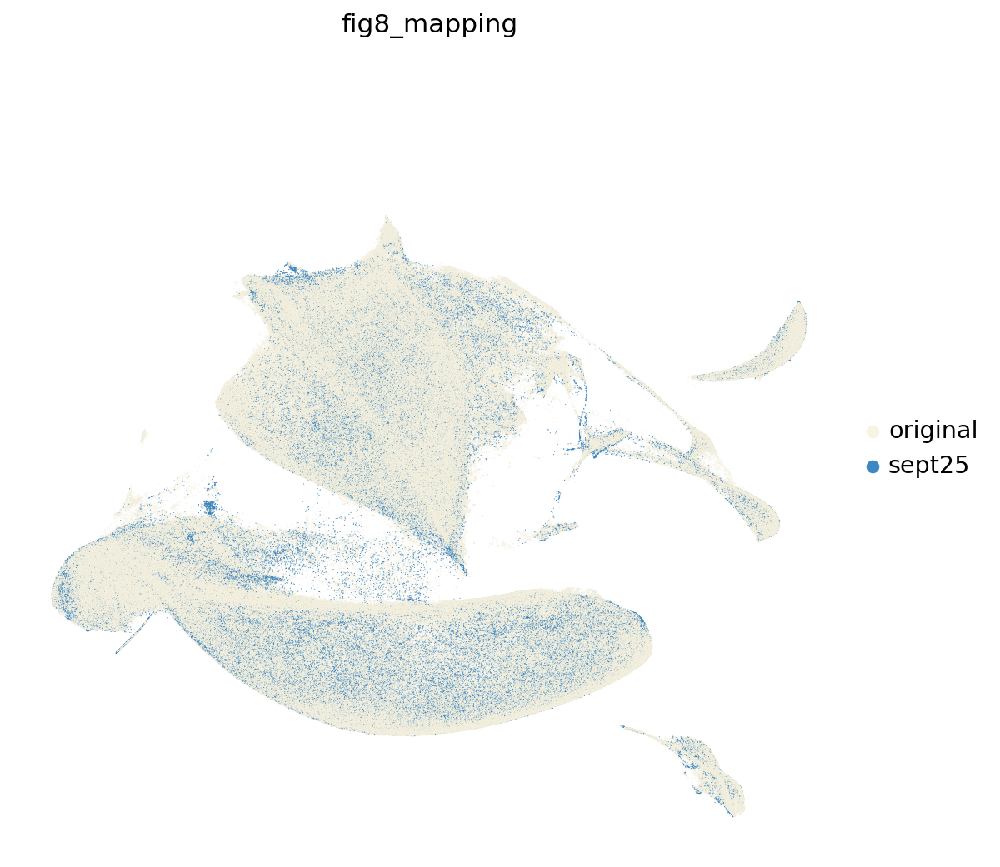

In [5]:
g_palette = {
    "original": "#f8f4e3",  
    "sept25": "#3d88c3",    
}

sc.pl.umap(
    adata,
    color="fig8_mapping",
    s=1,
    legend_fontoutline=2,
    palette=g_palette,
    edgecolor='black',
    linewidth=0.001,
    save="5c_data.pdf"
    
)


In [6]:
with open('/nfs/team298/ls34/niche_colors.pkl', 'rb') as f:
    colors_new2 = pickle.load(f)

In [7]:
fallback = mcolors.to_hex("lightgray", keep_alpha=True)  # '#d3d3d3ff'

adata.uns['provisional_colors'] = [
    colors_new2.get(cat, fallback)
    for cat in adata.obs['provisional'].cat.categories
]

In [8]:
cats = adata.obs['provisional'].cat.categories
palette = [colors_new2[c] for c in cats if c in colors_new2]

adata = adata[adata.obs['provisional'].isin(colors_new2.keys())].copy()
adata.uns['provisional_colors'] = palette
 
 
 

In [9]:
sc.settings.set_figure_params(dpi=50, dpi_save=300, facecolor="white", frameon=False, figsize=(30,30))

KEEP = ["Tzone-like", "Sebaceous_immune", "Plasma_cell_rich"]

adata.obs['provisional2'] = [x if x in KEEP else "Other" for x in  adata.obs['provisional'] ]
adata.obs['provisional2'] =adata.obs['provisional2'] .astype('category')
adata.uns['provisional2_colors'] = [colors_new2.get(cat, '#E0E0E0')  # Default to light grey if not found
                                     for cat in adata.obs['provisional2'].cat.categories]

 

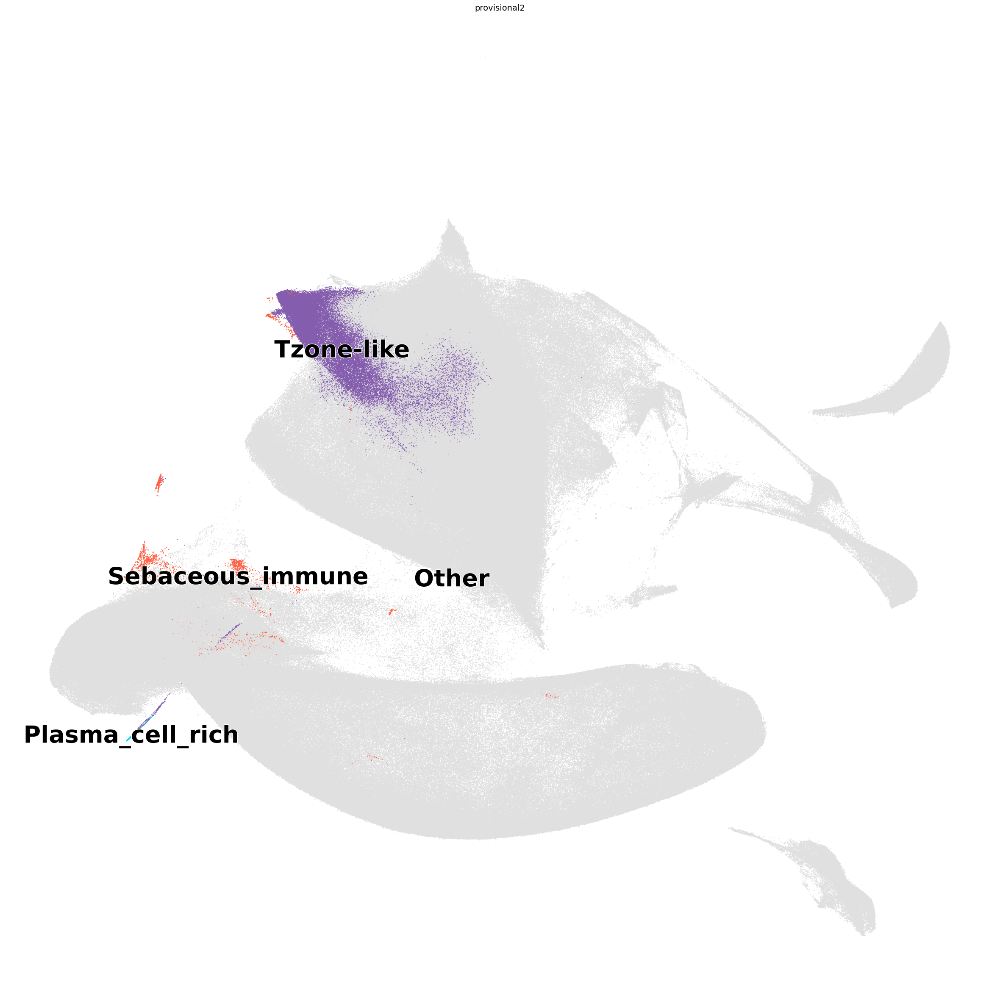

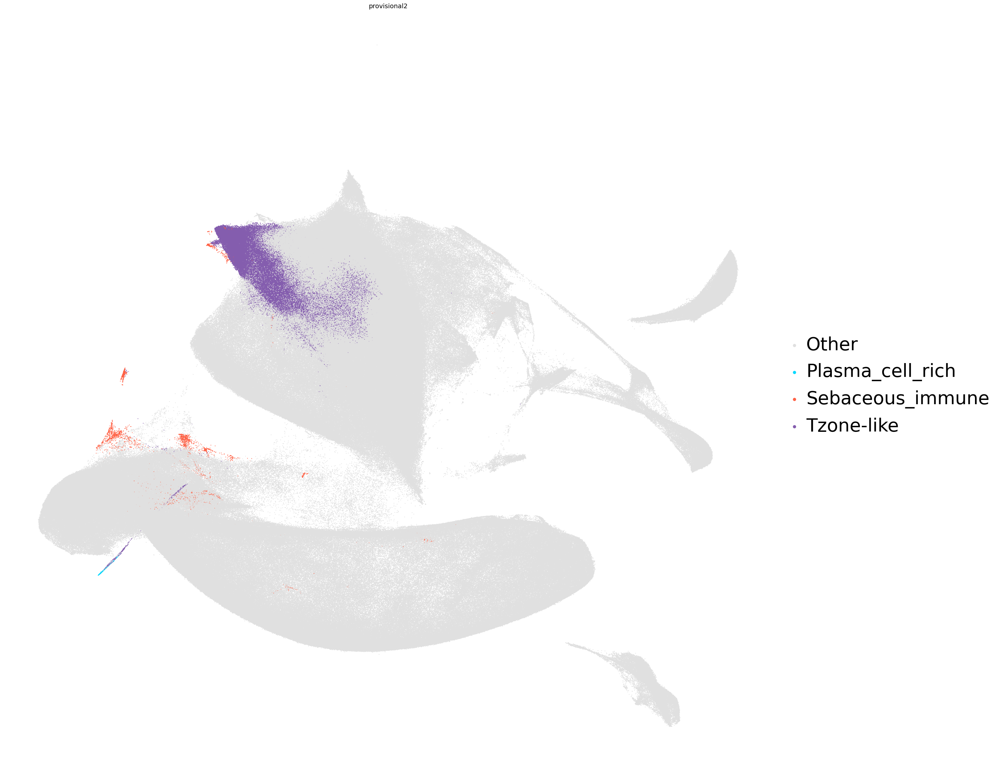

In [10]:
sc.pl.umap(adata,
         #  neighbors_key='neighborhood',
           color=['provisional2'],
          s=10,
                     legend_loc="on data",
                      legend_fontsize=40,

           legend_fontoutline=2,)
sc.pl.umap(adata,
         #  neighbors_key='neighborhood',
           color=['provisional2'],
          s=10,
                    # legend_loc="on data",
                      legend_fontsize=40,

           legend_fontoutline=2,
          save = "5c_niches.pdf")
 

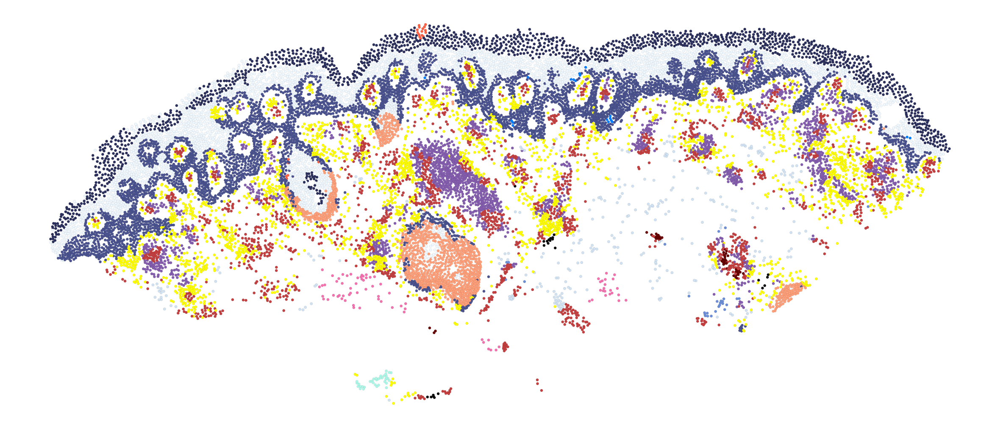

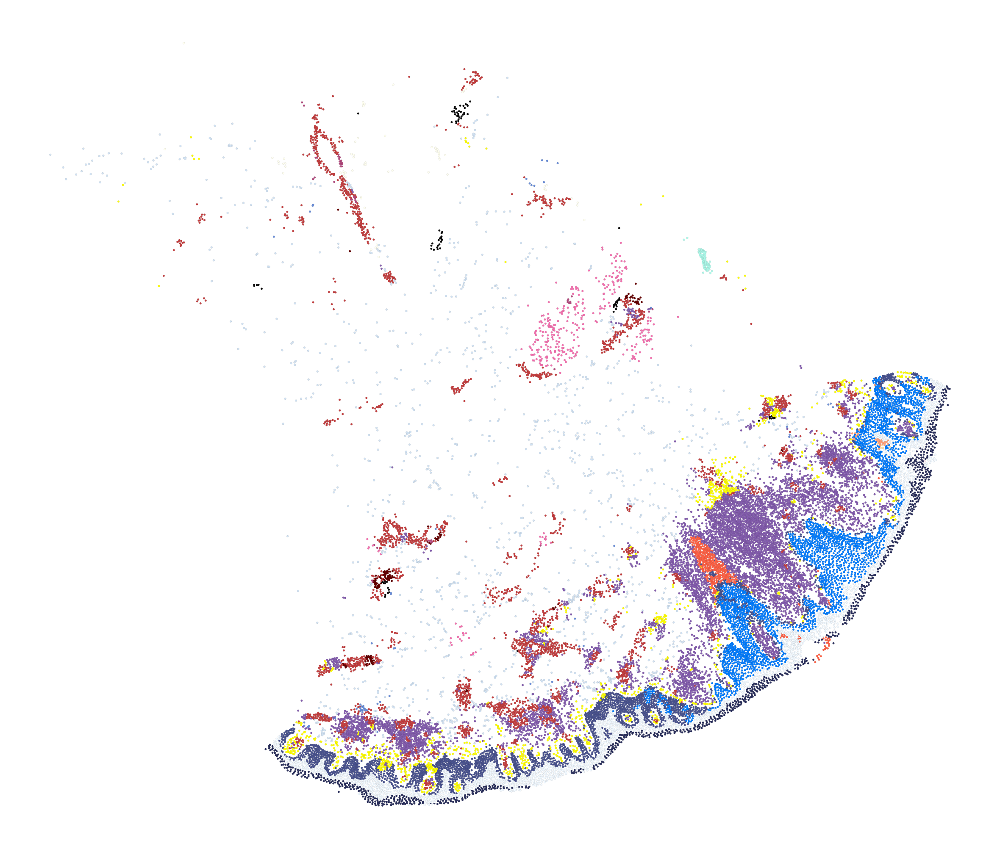

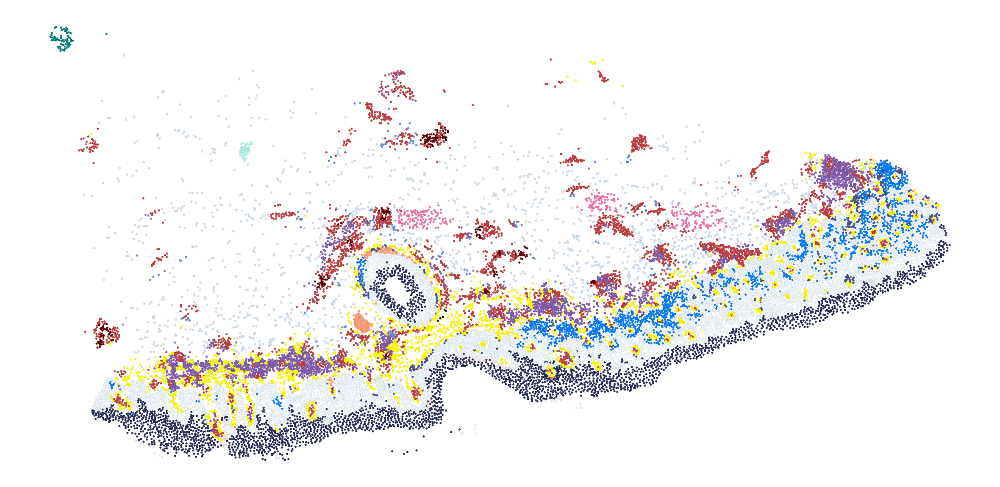

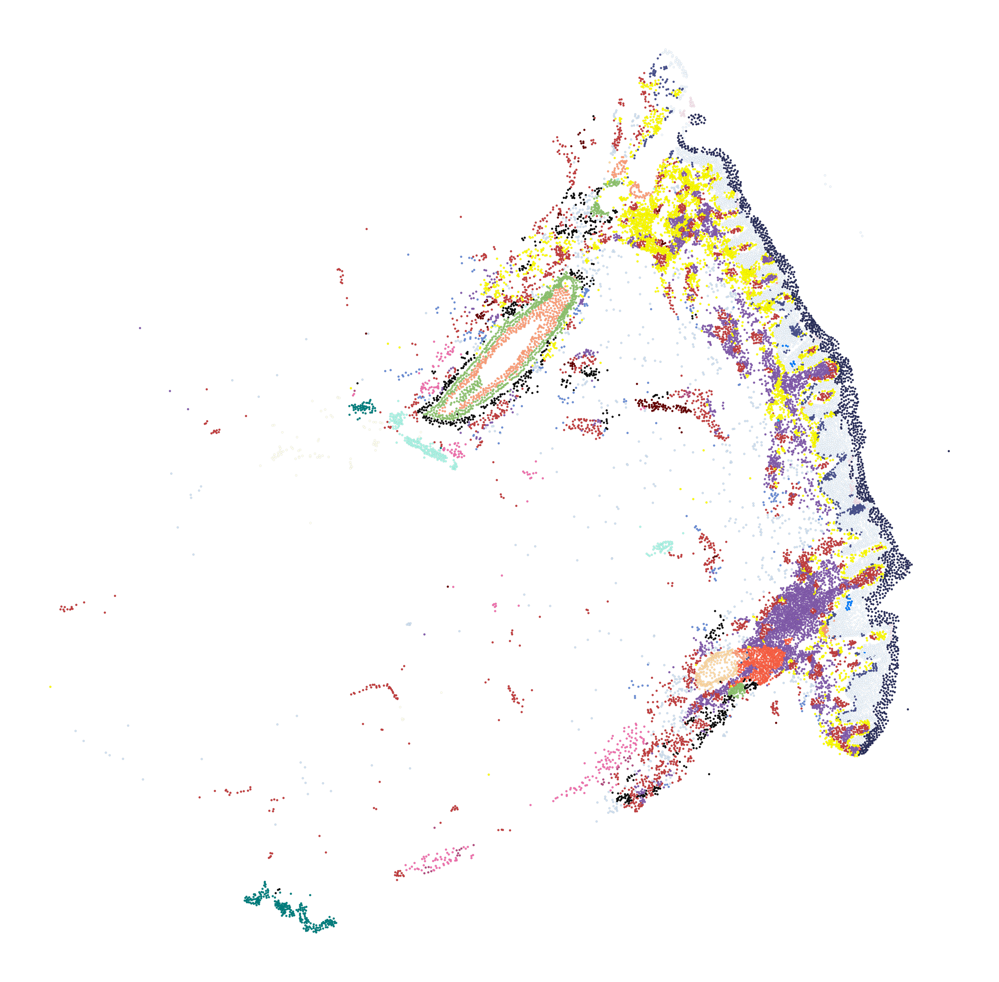

In [11]:
for x in [ 'BK39_Lesional Baseline',  'BK22_Lesional Baseline',
          'Lesional_CE3-SKI-24-FO-1-S22-A1',
        #  'Lesional_Baseline_resolved_CE3-SKI-24-FO-1-S22_replicate',
          # 'Lesional_CE3-SKI-24-FO-1-S22_replicate',
           'Lesional_CE4-SKI-27-FO-4-S22-A2',
      #'Lesional_CE4-SKI-27-FO-4-S22_replicate',

         ]:
    adata_i=adata[adata.obs["info_id6"]==x]

    # adata_i.obs[NICHE] =adata_i.obs[NICHE] .astype('category')
    # adata_i.uns[NICHE+'_colors'] = [colors_loaded.get(cat, '#D3D3D3')   
    #                                      for cat in adata_i.obs[NICHE].cat.categories]
    # # adata_i.obs['niche17_alt2'] =adata_i.obs['niche17_alt2'] .astype('category')
    # adata_i.uns['niche17_alt2_colors'] = [colors_loaded.get(cat, '#D3D3D3')   
    #                                      for cat in adata_i.obs['niche17_alt2'].cat.categories]
    sc.pl.spatial(
        adata_i,#[adata_i.obs["Timepoint"].str.startswith("Les")],
       # library_id="spatial",
      #  shape=None,
        color=["provisional"],
        spot_size=10,
        vmax=1,
                edgecolor="black",
        linewidth=0.05,
                legend_fontsize=12,
        title="",
        legend_loc=None,
        save=f"NEMObutnichecompass_niches_{x}.pdf",
       
    )
    #     if i>1:
    #         break


# Prevalence plots

In [12]:
# MINIMUM_PERCENT      = 0.5
# MIN_PERCENT_FOR_TEXT = 5
# CELL_ANNOTATION = "lvl5_annotation"

# adata_filtered = adata[adata.obs["provisional2"]=="Plasma_cell_rich"]
# ordered_celltypes=adata_filtered.obs[CELL_ANNOTATION].unique()

# df = adata_filtered.obs[[CELL_ANNOTATION, "fig8_mapping"]].copy()

        
        
        
# count_tbl = (
#     df.groupby(["fig8_mapping", CELL_ANNOTATION])
#       .size()
#       .reset_index(name="cell_count")
# )

# pivot = (
#     count_tbl.pivot(index="fig8_mapping",
#                     columns=CELL_ANNOTATION,
#                     values="cell_count")
#           .fillna(0)
# )

# ordered_celltypes = [ct for ct in ordered_celltypes if ct in pivot.columns]
# pivot       = pivot[ordered_celltypes]
# proportions = pivot.div(pivot.sum(axis=1), axis=0) * 100


# # colours for cell types
# plot_colors = [colors.get(ct, "grey") for ct in ordered_celltypes]

# # ─────────────────────────────────────────────────────────────
# # 3 · Stacked horizontal bar plot
# # ─────────────────────────────────────────────────────────────
# fig, ax = plt.subplots(figsize=(16, 2))

# proportions.plot(
#     kind="barh",
#     stacked=True,
#     color=plot_colors,
#     edgecolor="black",
#     ax=ax
# )

# # annotate slices above 5 %
# for i, (_, row) in enumerate(proportions.iterrows()):
#     cum = 0
#     for j, val in enumerate(row):
#         if val > MIN_PERCENT_FOR_TEXT:
#             ax.text(
#                 cum + val / 2,
#                 i,
#                 ordered_celltypes[j],
#                 ha="center",
#                 va="center",
#                 fontsize=10,
#                 color="black",
#                 clip_on=True,
#             )
#         cum += val

# ax.set_ylabel("", fontsize=15)
# ax.set_xlabel("",    fontsize=15)
# ax.set_title(f"", fontsize=16)

# ax.set_yticks(range(len(proportions)))
# #ax.set_yticklabels(ytick_labels, fontsize=14)

# ax.set_xticks([0, 50, 100])
# ax.set_xticklabels(["0%", "50%", "100%"], fontsize=14)

# ax.legend(
#     title="",
#     #labels=ordered_celltypes,
#     loc="upper center",
#     bbox_to_anchor=(0.5, -0.35),
#     ncol=6,
#     fontsize=10,
#     title_fontsize=10,
#     frameon=False,
# )

# ax.grid(False)
# ax.spines["top"].set_visible(False)
# ax.spines["right"].set_visible(False)

# plt.tight_layout()
# fig.savefig("fig5/plasma_niche_composition.pdf", dpi=300, bbox_inches="tight")

# plt.show()
 

In [13]:

# # ─────────────────────────────────────────────────────────────
# # Collapse categories <2% into "Other"
# # ─────────────────────────────────────────────────────────────
# threshold = 2
# proportions_other = proportions.copy()

# # Compute "Other" as the sum of all <2% values for each bar
# proportions_other["Other"] = proportions_other.apply(
#     lambda row: row[row < threshold].sum(), axis=1
# )

# # Zero out those small values (so they don’t get double-plotted)
# proportions_other[proportions_other < threshold] = 0

# # Add a color for "Other" (light gray for clarity)
# plot_colors_extended = plot_colors + ["lightgray"]

# # ─────────────────────────────────────────────────────────────
# # Plot stacked vertical bar chart
# # ─────────────────────────────────────────────────────────────
# fig, ax = plt.subplots(figsize=(6, 6))

# proportions_other.plot(
#     kind="bar",
#     stacked=True,
#     color=plot_colors_extended,
#     edgecolor="black",
#     ax=ax
# )

# ax.set_xlabel("", fontsize=15)
# ax.set_ylabel("Proportion (%)", fontsize=15)

# ax.set_xticks(range(len(proportions_other)))
# ax.set_xticklabels(proportions_other.index, rotation=0, ha="right", fontsize=12)

# ax.set_yticks([0, 50, 100])
# ax.set_yticklabels(["0%", "50%", "100%"], fontsize=12)

# ax.legend(
#     title="",
#     loc="center left",            # anchor legend to the left-center of bbox
#     bbox_to_anchor=(1.02, 0.5),   # push it just outside the axes to the right
#     ncol=2,                       # vertical legend
#     fontsize=10,
#     title_fontsize=10,
#     frameon=False,
# )
# ax.grid(False)
# ax.spines["top"].set_visible(False)
# ax.spines["right"].set_visible(False)

# plt.tight_layout()
# fig.savefig("fig5/plasmacell_niche_composition_vertical.pdf", dpi=300, bbox_inches="tight")
# plt.show()

In [14]:
# CELL_ANNOTATION      = 'lvl5_annotation'
# MINIMUM_PERCENT      = 2
# MIN_PERCENT_FOR_TEXT = 5


# adata_filtered = adata[adata.obs["provisional2"] == "Sebaceous_immune"]

# df = adata_filtered.obs[[CELL_ANNOTATION, "fig8_mapping"]].copy()

# count_tbl = (
#     df.groupby(["fig8_mapping", CELL_ANNOTATION])
#       .size()
#       .reset_index(name="cell_count")
# )

# pivot = (
#     count_tbl.pivot(index="fig8_mapping",
#                     columns=CELL_ANNOTATION,
#                     values="cell_count")
#           .fillna(0)
# )

# proportions = pivot.div(pivot.sum(axis=1), axis=0) * 100



# proportions_masked = proportions.mask(proportions < MIN_PERCENT_FOR_TEXT, 0)
# proportions_masked = proportions_masked.loc[:, (proportions_masked > 0).any(axis=0)]
# proportions_filtered = proportions_masked.div(proportions_masked.sum(axis=1), axis=0) * 100

# plot_colors = [colors.get(ct, "grey") for ct in proportions_filtered.columns]


# fig, ax = plt.subplots(figsize=(16, 2))

# proportions_filtered.plot(
#     kind="barh",
#     stacked=True,
#     color=plot_colors,
#     edgecolor="black",
#     ax=ax
# )

# # annotate slices above threshold
# for i, (_, row) in enumerate(proportions_filtered.iterrows()):
#     cum = 0
#     for j, val in enumerate(row):
#         if val > MIN_PERCENT_FOR_TEXT:
#             ax.text(
#                 cum + val / 2,
#                 i,
#                 proportions_filtered.columns[j],
#                 ha="center",
#                 va="center",
#                 fontsize=10,
#                 color="black",
#                 clip_on=True,
#             )
#         cum += val

# ax.set_ylabel("", fontsize=15)
# ax.set_xlabel("", fontsize=15)
# ax.set_title("", fontsize=16)

# ax.set_yticks(range(len(proportions_filtered)))
# ax.set_xticks([0, 50, 100])
# ax.set_xticklabels(["0%", "50%", "100%"], fontsize=14)

# ax.legend(
#     title="",
#     loc="upper center",
#     bbox_to_anchor=(0.5, -0.35),
#     ncol=6,
#     fontsize=10,
#     title_fontsize=10,
#     frameon=False,
# )

# ax.grid(False)
# ax.spines["top"].set_visible(False)
# ax.spines["right"].set_visible(False)

# plt.tight_layout()
# plt.show()

In [15]:
adata_plots=adata.copy()
RENAME = {
 'ILC1': 'ILC1',
 'ILC2': 'ILC2',
 'ILC3': 'ILC3',
 'ILC3_CCL1+PTGDS+': 'ILC3_CCL1+PTGDS+',
 'KC': 'KC',
 'KC1': 'KC',
 'KC1-2_cycling': 'KC',
 'KC2/3_cycling': 'KC',
 'KC3': 'KC',
 'KC5': 'KC',
 'KC_Sebocyte_DuctInner': 'KC_Sebocyte_DuctInner',
 'KC_Sebocyte_DuctInner_Junction': 'KC_Sebocyte_DuctInner_Junction',
 'KC_Sebocyte_DuctOuter': 'KC_Sebocyte_DuctOuter',
 'KC_Sebocyte_GlandBasal': 'KC_Sebocyte_GlandBasal',
 'KCinflamm_basal': 'KC',
 'LC': 'LC',
 'Mac2': 'Mac2',
 'Mast cell': 'Mast cell',
 'Melanocyte': 'Melanocyte',
 'MigDC (cDC1)': 'MigDC (cDC1)',
 'MigDC (cDC2)': 'MigDC (cDC2)',
 'MoDC': 'MoDC',
 'Monocyte': 'Monocyte',
 'NK': 'NK',
 'Sweat gland channel outer': 'Sweat gland channel outer',
 'T': 'T',
 'TRM_IL13+': 'TRM_IL13+',
 'TRM_IL17+': 'TRM_IL17+',
 'T_Prolif': 'T_Prolif',
 'Tc0': 'Tc',
 'Tc1': 'Tc',
 'Tc2': 'Tc',
 'Tc3_IFNGhi': 'Tc',
 'Th': 'Th',
 'Th/TRM prolif': 'Th/TRM prolif',
 'Tnaive': 'Tnaive',
 'Treg': 'Treg',
 'Treg/Tnaive_prolif': 'Treg/Tnaive_prolif',
 'Treg_LRRC32+': 'Treg_LRRC32+',
 'VE3_Ven': 'VE3_Ven',
 'cDC': 'cDC',
 'cDC1': 'cDC1',
 'cDC2': 'cDC2',
 'cDC2: EREG+CCR7+': 'cDC2: EREG+CCR7+',
 'cDC2: MMP12hi': 'cDC2: MMP12hi',
 'cDC2_cycling': 'cDC2_cycling',
 'pDC': 'pDC',
'F1: Superficial': 'F1: Superficial',
 'F2: Universal': 'F2: Universal',}
adata_plots.obs["lvl5_annotation"]=adata_plots.obs["lvl5_annotation"].map(RENAME).fillna(adata_plots.obs["lvl5_annotation"])
adata_plots.obs["lvl5_annotation"].value_counts()

lvl5_annotation
KC                                543446
F2: Universal                     125219
Pericyte1                         102214
VE3_Ven                            84369
F1: Superficial                    80511
                                   ...  
F6: Inflammatory myofibroblast        23
Neutrophil                            19
ILC_Prolif                            10
Mac_CX3CR1+                            8
ILC1_NCR2+P2RX7+                       8
Name: count, Length: 90, dtype: int64

In [16]:
# CELL_ANNOTATION      = 'lvl5_annotation'
# MIN_PERCENT_FOR_TEXT = 1

# threshold = 4


adata_filtered = adata_plots[adata_plots.obs["provisional2"] == "Sebaceous_immune"]

# df = adata_filtered.obs[[CELL_ANNOTATION, "fig8_mapping"]].copy()

# count_tbl = (
#     df.groupby(["fig8_mapping", CELL_ANNOTATION])
#       .size()
#       .reset_index(name="cell_count")
# )

# pivot = (
#     count_tbl.pivot(index="fig8_mapping",
#                     columns=CELL_ANNOTATION,
#                     values="cell_count")
#           .fillna(0)
# )

# proportions = pivot.div(pivot.sum(axis=1), axis=0) * 100


# proportions_other = proportions.copy()


# proportions_other["Other"] = proportions_other.apply(
#     lambda row: row[row < threshold].sum(), axis=1
# )


# proportions_other[proportions_other < threshold] = 0
# proportions_other = proportions_other.loc[:, (proportions_other > 0).any(axis=0)]
# proportions_other = proportions_other.div(proportions_other.sum(axis=1), axis=0) * 100
# plot_colors_extended = [colors.get(ct, "grey") for ct in proportions_other.columns[:-1]] + ["lightgray"]


# fig, ax = plt.subplots(figsize=(6, 6))

# proportions_other.plot(
#     kind="bar",
#     stacked=True,
#     color=plot_colors_extended,
#     edgecolor="black",
#     ax=ax
# )

# ax.set_xlabel("", fontsize=15)
# ax.set_ylabel("Proportion (%)", fontsize=15)

# ax.set_xticks(range(len(proportions_other)))
# ax.set_xticklabels(proportions_other.index, rotation=0, ha="right", fontsize=12)

# ax.set_yticks([0, 50, 100])
# ax.set_yticklabels(["0%", "50%", "100%"], fontsize=12)

# ax.legend(
#     title="",
#     loc="center left",
#     bbox_to_anchor=(1.02, 0.5),
#     ncol=2,
#     fontsize=10,
#     title_fontsize=10,
#     frameon=False,
# )


# ax.grid(False)
# ax.spines["top"].set_visible(False)
# ax.spines["right"].set_visible(False)

# plt.tight_layout()
# fig.savefig("fig5/sebaceous_niche_composition_vertical.pdf", dpi=300, bbox_inches="tight")
# plt.show()

In [17]:
ALL_T = {'Conventional': ['CD3D', "CD4", "CD8A"],
 'Treg': ['FOXP3', 'TIGIT', 'CTLA4', 'IL2RA'],
 'Activated_Treg': ['LRRC32',
  'IL1R1',
  'IL1R2',
 # 'CMSS1',
  'LAYN',
  'CCR8',
  'NR4A1'],
 'TR1': ['EOMES',
  'IL10',
  'LAG3',
  'HAVCR2',
  'PDCD1',
  'FOXB1',
  'TNFSF9',
 # 'VCAM1'
        ],
  
 'Naive/Tcm': ['SELL', 'CCR7', 'S1PR1', 'TCF7', 'PAK2', 'ICAM2', 'PASK', ],
 'GIMAPs': ['GIMAP1', 'GIMAP4', 'GIMAP5', 'GIMAP7'],
 'Th': ['CD4', 'CD40LG', 'MCAM', ],
 'Th_PPARGhi': ['PPARG', 'BTD', 'KIF13B', 'DGKH', 'RORA-AS1','SPAG1',
         'XYLT1', 'GNAQ',  'ZEB2', # 'PTGS2', 'MMP7',
        "ZHX2",'CCR6', 'BACH2', "CXCR6",
               ],
         #"CD8": ["CD8A"],
        
                
 'CD8A+ cytotoxic T cells': [ 'GZMA', 'GZMK', 'CCL4','NKG7', 'CCL5',  ],
           'Tc0': ['DONSON', 'GPR15', 'CD8B2', 'IL9R', 
                     #"AGAP1", "C12orf42", "GML", "CCR5",
                     ],

         'IFNG': ["KLRG1",'IFNG', 'TNFSF9', 'CCL3'],
 'Tissue-residency\n markers': ['CD8A', 'ITGAE', 'CD109', 'ZNF683', 'ENTPD1'],
 'T_2': ['IL22', 'IL13', 'NBAS',# 'CCL17',
         'AREG', 'IL9R', 'PDLIM4', 'CCR8'],
 'TRM_IL13': ['ZBTB16', 'KLRC4', 'ADGRG1', 'RGS9'],
 'T_17': ['IL17A',
  'IL17F',
  'CXCL13',
  'CCL20',
  'IL23R',
  'RORC',
  'ADAM12',  'LRRN3',
  'MYO7A',
  'IL21',],
    'Mixed': [

  'CTSH',
  'VDR',
  'CCR6',
  'IL26'
         ],
 'Other': ['PTPN13', #'ITGA1'
          ],
 'ITGA1hi': ['ITGA1', 'ZHX2', 'BICD1', 'PRR5L', 'ST8SIA1', 'ZNF407', "KLRG1"],
 'Memory': ['CD69'],
 'Gamma-delta': ['FXYD2',
  'TRGC2',
  'TRDV1',
  'TRGV4',
  'EMP1',
  'NSG1',
  'MPZL2',
  'XCL1',
  'KLRC2',
  'KLRC3',
  'KLRD1',
  'TRDC',
  'VSTM2L',
  'LAT2',
  'SPINT2',
  'KRT86',
  'FCER1G',
  'TRDV1',
  'SPRY2'],
 'Innate': [#'KLRC2', 'KLRC3', 'KLRB1', 'KIT', 'KLRC1',
     'TYROBP',],
                 'Cycling': ['UBE2C', 'MKI67', 'TOP2A'],
        }
 
def remove_markers(LIST):
    try: 
        LIST = {key: [gene for gene in genes if gene in adata.var_names] 
                           for key, genes in LIST.items()}
    except: 
        LIST =[gene for gene in LIST if gene in adata.var_names]
    return LIST 
adata_filtered_iii= adata_filtered[adata_filtered.obs["fig8_mapping"]=="sept25"]
# sc.pl.dotplot(adata_filtered_iii[adata_filtered_iii.obs["lvl5_annotation"]=="T"], 
#               remove_markers(ALL_T),
#               groupby="lvl5_annotation",
#               dendrogram=False, 
#                 #standard_scale="var",
#               dot_max=0.3,
#               vmax=.8
#                )

In [18]:
# threshold = 1
# proportions_other = proportions.copy()

# proportions_other["Other"] = proportions_other.apply(
#     lambda row: row[row < threshold].sum(), axis=1
# )

# proportions_other[proportions_other < threshold] = 0
# plot_colors_extended = plot_colors + ["lightgray"]
# fig, ax = plt.subplots(figsize=(12, 12))

# proportions_other.plot(
#     kind="bar",
#     stacked=True,
#     color=plot_colors_extended,
#     edgecolor="black",
#     ax=ax
# )

# ax.set_xlabel("", fontsize=15)
# ax.set_ylabel("Proportion (%)", fontsize=15)

# ax.set_xticks(range(len(proportions_other)))
# ax.set_xticklabels(proportions_other.index, rotation=0, ha="right", fontsize=12)

# ax.set_yticks([0, 50, 100])
# ax.set_yticklabels(["0%", "50%", "100%"], fontsize=12)

# ax.legend(
#     title="",
#     loc="center left",            # anchor legend to the left-center of bbox
#     bbox_to_anchor=(1.02, 0.5),   # push it just outside the axes to the right
#     ncol=2,                       # vertical legend
#     fontsize=10,
#     title_fontsize=10,
#     frameon=False,
# )
# ax.grid(False)
# ax.spines["top"].set_visible(False)
# ax.spines["right"].set_visible(False)

# plt.tight_layout()
# fig.savefig("fig5/sebimmune_niche_composition_vertical.pdf", dpi=300, bbox_inches="tight")
# plt.show()

In [19]:
MINIMUM_PERCENT      = 0.5
MIN_PERCENT_FOR_TEXT = 5

CELL_ANNOTATION='lvl5_annotation'

adata_filtered = adata[adata.obs["provisional2"]=="Sebaceous_immune"]
ordered_celltypes=adata_filtered.obs[CELL_ANNOTATION].unique()
#adata_filtered.obs["info_id6"].value_counts()

In [20]:
# df = adata_filtered.obs[[CELL_ANNOTATION, "info_id6"]].copy()      
        
# count_tbl = (
#     df.groupby(["info_id6", CELL_ANNOTATION])
#       .size()
#       .reset_index(name="cell_count")
# )

# pivot = (
#     count_tbl.pivot(index="info_id6",
#                     columns=CELL_ANNOTATION,
#                     values="cell_count")
#           .fillna(0)
# )

# ordered_celltypes = [ct for ct in ordered_celltypes if ct in pivot.columns]
# pivot       = pivot[ordered_celltypes]
# proportions = pivot.div(pivot.sum(axis=1), axis=0) * 100



# plot_colors = [colors.get(ct, "grey") for ct in ordered_celltypes]



# fig, ax = plt.subplots(figsize=(16, 2))

# proportions.plot(
#     kind="barh",
#     stacked=True,
#     color=plot_colors,
#     edgecolor="black",
#     ax=ax
# )

# for i, (_, row) in enumerate(proportions.iterrows()):
#     cum = 0
#     for j, val in enumerate(row):
#         if val > MIN_PERCENT_FOR_TEXT:
#             ax.text(
#                 cum + val / 2,
#                 i,
#                 ordered_celltypes[j],
#                 ha="center",
#                 va="center",
#                 fontsize=10,
#                 color="black",
#                 clip_on=True,
#             )
#         cum += val

# ax.set_ylabel("", fontsize=15)
# ax.set_xlabel("",    fontsize=15)
# ax.set_title(f"", fontsize=16)

# ax.set_yticks(range(len(proportions)))
# #ax.set_yticklabels(ytick_labels, fontsize=14)

# ax.set_xticks([0, 50, 100])
# ax.set_xticklabels(["0%", "50%", "100%"], fontsize=14)

# ax.legend(
#     title="",
#     #labels=ordered_celltypes,
#     loc="upper center",
#     bbox_to_anchor=(0.5, -0.35),
#     ncol=6,
#     fontsize=10,
#     title_fontsize=10,
#     frameon=False,
# )

# ax.grid(False)
# ax.spines["top"].set_visible(False)
# ax.spines["right"].set_visible(False)

# plt.tight_layout()
# #fig.savefig("fig5/plasma_niche_composition.pdf", dpi=300, bbox_inches="tight")#
# # plt.show()
 

In [21]:
# threshold = 2
# proportions_other = proportions.copy()

# proportions_other["Other"] = proportions_other.apply(
#     lambda row: row[row < threshold].sum(), axis=1
# )

# proportions_other[proportions_other < threshold] = 0
# plot_colors_extended = plot_colors + ["lightgray"]

# fig, ax = plt.subplots(figsize=(12, 12))

# proportions_other.plot(
#     kind="bar",
#     stacked=True,
#     color=plot_colors_extended,
#     edgecolor="black",
#     ax=ax
# )

# ax.set_xlabel("", fontsize=15)
# ax.set_ylabel("Proportion (%)", fontsize=15)

# ax.set_xticks(range(len(proportions_other)))
# ax.set_xticklabels(proportions_other.index, rotation=0, ha="right", fontsize=12)

# ax.set_yticks([0, 50, 100])
# ax.set_yticklabels(["0%", "50%", "100%"], fontsize=12)

# ax.legend(
#     title="",
#     loc="center left",            # anchor legend to the left-center of bbox
#     bbox_to_anchor=(1.02, 0.5),   # push it just outside the axes to the right
#     ncol=2,                       # vertical legend
#     fontsize=10,
#     title_fontsize=10,
#     frameon=False,
# )
# ax.grid(False)
# ax.spines["top"].set_visible(False)
# ax.spines["right"].set_visible(False)

# plt.tight_layout()
# #fig.savefig("fig5/sebimmune_niche_composition_vertical.pdf", dpi=300, bbox_inches="tight")
# plt.show()

In [22]:
adata_i=adata[adata.obs["all_vs_core"]!="novel_timepoints"]
adata_i=adata_i[adata_i.obs["fig8_mapping"]!="original"]


# plasma cell niche

BK27-SKI-27-FO-1-S6-C1


/tmp/ipykernel_3282227/4215510427.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_hair.obs['provisional'] =adata_hair.obs['provisional'] .astype('category')


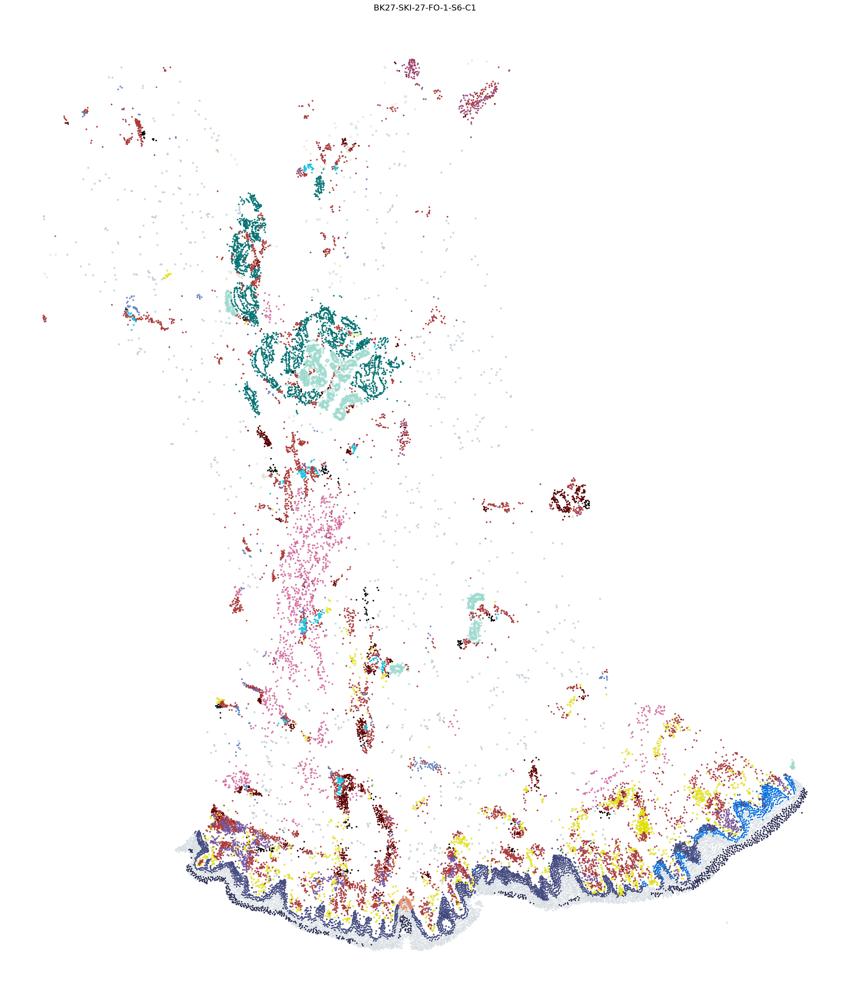

BK27-SKI-27-FO-5-S9-D1


/tmp/ipykernel_3282227/4215510427.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_hair.obs['provisional'] =adata_hair.obs['provisional'] .astype('category')


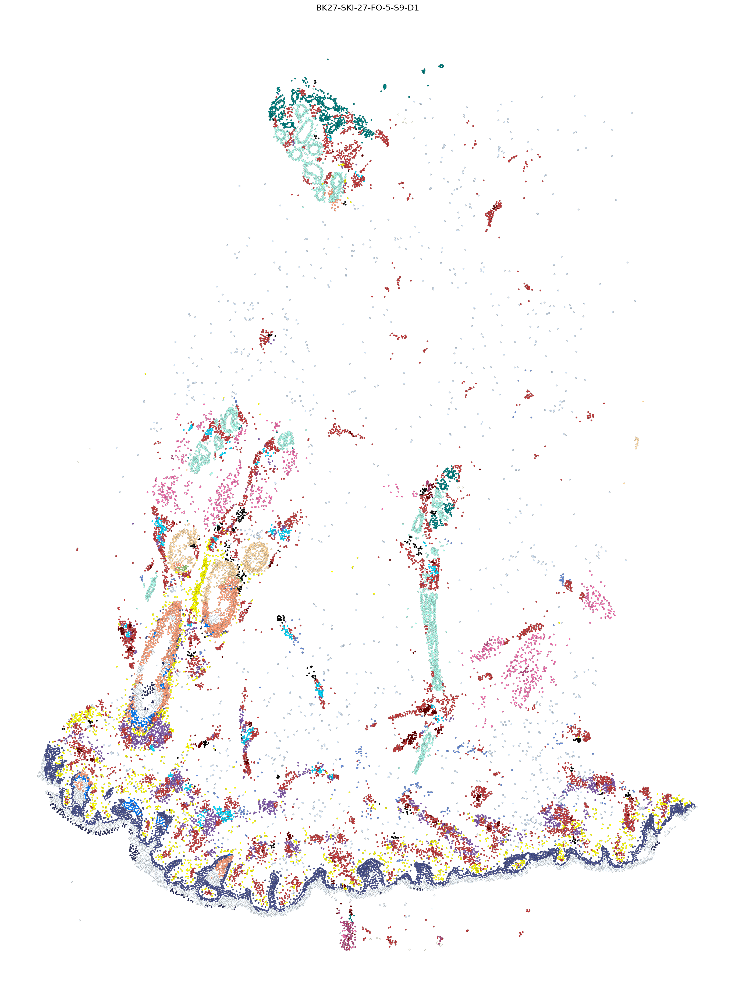

In [23]:
sc.settings.set_figure_params(dpi_save=600, facecolor="white", frameon=False, figsize=(30,30))
SPOT_SIZE=15
LINEWIDTH = 0.2


for x in sorted(["BK27-SKI-27-FO-5-S9-D1", "BK27-SKI-27-FO-1-S6-C1"]):
    print(x)
    adata_hair = adata_i[adata_i.obs["info_id6"]==x]

    adata_hair.obs['provisional'] =adata_hair.obs['provisional'] .astype('category')
    adata_hair.uns['provisional_colors'] = [colors_new2.get(cat, '#D3D3D3')  # Default to light grey if not found
                                         for cat in adata_hair.obs['provisional'].cat.categories]


    sc.pl.spatial(
        adata_hair,#[adata_i.obs["Timepoint"].str.startswith("Les")],
       # library_id="spatial",
        #shape=None,
        color="provisional",
        spot_size=10 ,
      #  vmax=1,
        #title=str(STATUS) + "_" + DONOR_ID,
        title=x,
        #title=INFO_ID, #+ "_nonlesional",
     legend_loc=None,
        # legend_loc="on data",
                edgecolor="black",
        linewidth=0.1,
                legend_fontsize=12,
               save=f"5d_plasmacell_{x}_BYNICHE.pdf"

       # save="fig2_day14_by_niche_legend.pdf"

        #ax=ax,
        #legend_loc="on data"  # Disable the legend for each subplot
    )

sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(30,30))



BK27-SKI-27-FO-5-S9-D1


/tmp/ipykernel_3282227/2621781015.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_hair.obs[CELL_ANNOTATION] =adata_hair.obs[CELL_ANNOTATION] .astype('category')


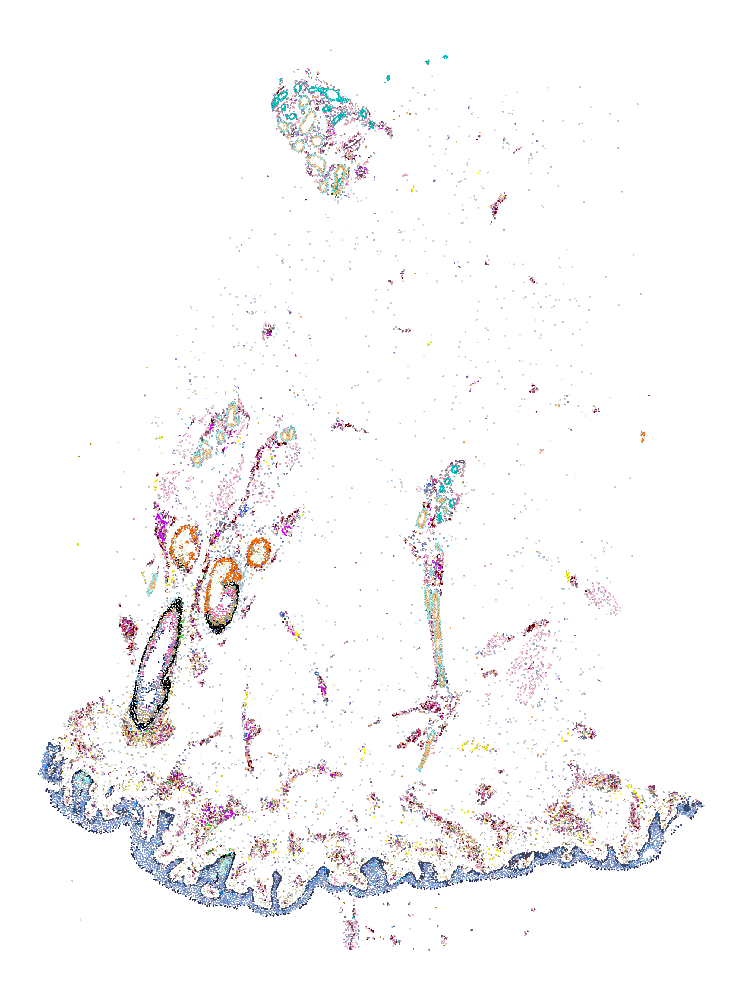

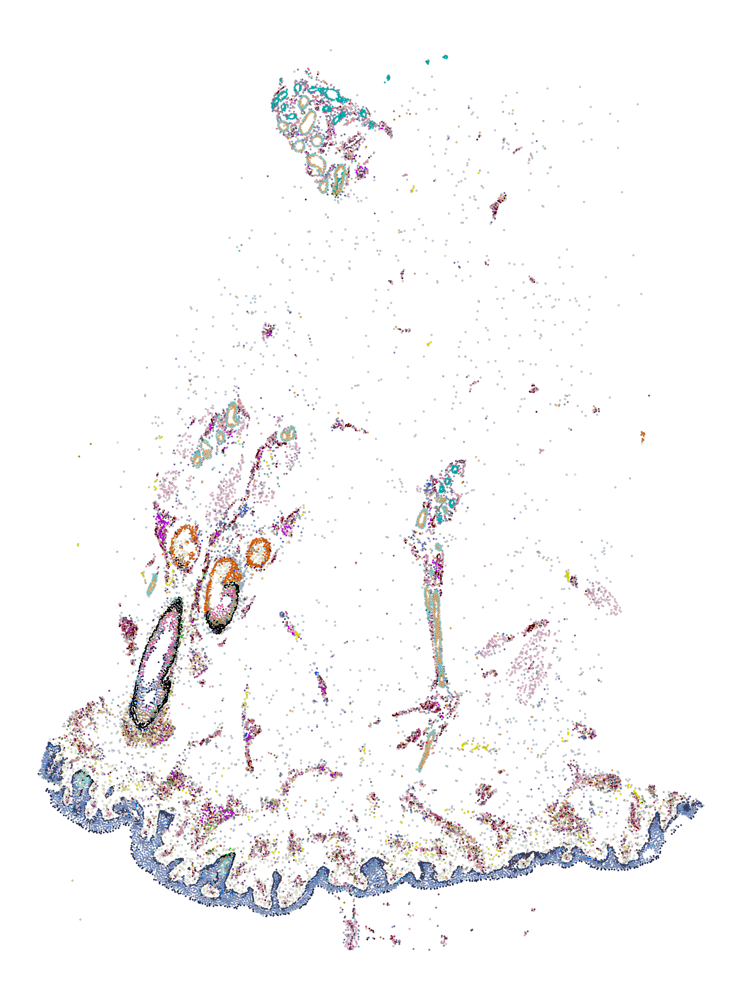

In [24]:
sc.settings.set_figure_params(dpi_save=600, facecolor="white", frameon=False, figsize=(30,30))

for x in sorted(["BK27-SKI-27-FO-5-S9-D1",
                 #"BK27-SKI-27-FO-1-S6-C1"
                ]):
    print(x)
    adata_hair = adata_i[adata_i.obs["info_id6"]==x]

    adata_hair.obs[CELL_ANNOTATION] =adata_hair.obs[CELL_ANNOTATION] .astype('category')
    adata_hair.uns[CELL_ANNOTATION+'_colors'] = [colors.get(cat, '#D3D3D3')  # Default to light grey if not found
                                         for cat in adata_hair.obs[CELL_ANNOTATION].cat.categories]


    sc.pl.spatial(
        adata_hair,#[adata_i.obs["Timepoint"].str.startswith("Les")],
       # library_id="spatial",
        #shape=None,
        color=CELL_ANNOTATION,
        spot_size=10,
      #  vmax=1,
        #title=str(STATUS) + "_" + DONOR_ID,
        #title=INFO_ID, #+ "_nonlesional",
     legend_loc=None,
        # legend_loc="on data",
                edgecolor="black",
        linewidth=0.1,
                legend_fontsize=12,
               save=f"5f_plasma_CELLTYPES.pdf",
        title="",

       # save="fig2_day14_by_niche_legend.pdf"

        #ax=ax,
        #legend_loc="on data"  # Disable the legend for each subplot
    )

    
    sc.pl.spatial(
        adata_hair,#[adata_i.obs["Timepoint"].str.startswith("Les")],
       # library_id="spatial",
        #shape=None,
        color=CELL_ANNOTATION,
        spot_size=10,
      #  vmax=1,
        #title=str(STATUS) + "_" + DONOR_ID,
        #title=INFO_ID, #+ "_nonlesional",
     legend_loc=None,
        # legend_loc="on data",
                edgecolor="black",
        linewidth=0.2,
                legend_fontsize=12,
               save=f"5f_plasma_CELLTYPES_v2.pdf",
        title="",

       # save="fig2_day14_by_niche_legend.pdf"

        #ax=ax,
        #legend_loc="on data"  # Disable the legend for each subplot
    )
sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(18,18))



# sebimmune niche

BK21-SKI-27-FO1-S11-C1


/tmp/ipykernel_3282227/3127909363.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_hair.obs['provisional'] =adata_hair.obs['provisional'] .astype('category')


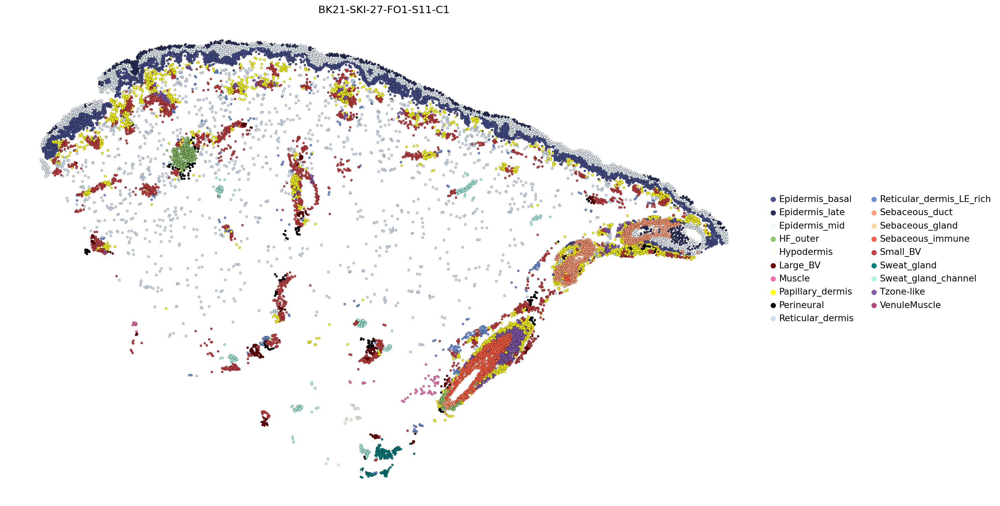

BK51-SKI-27-FO-2-S9-B2


/tmp/ipykernel_3282227/3127909363.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_hair.obs['provisional'] =adata_hair.obs['provisional'] .astype('category')


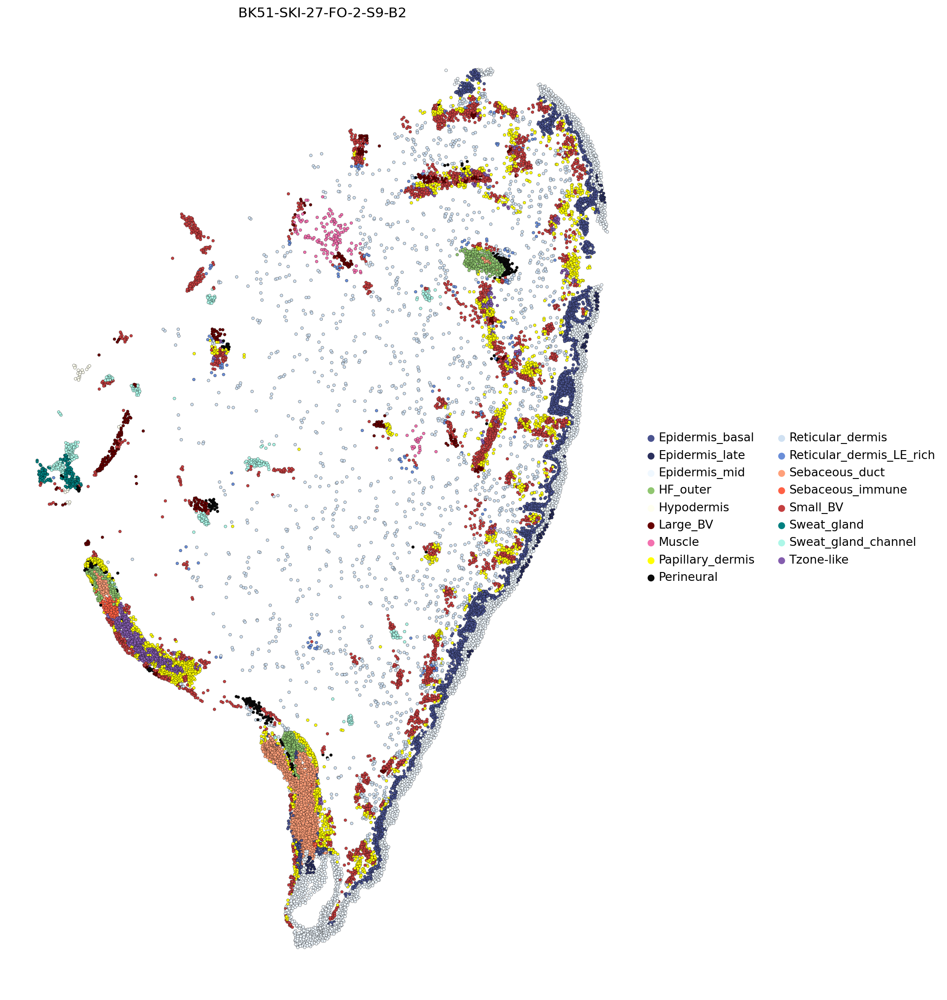

In [25]:
sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(18,18))

for x in sorted(["BK21-SKI-27-FO1-S11-C1", "BK51-SKI-27-FO-2-S9-B2",
      
                ]):
    print(x)
    adata_hair = adata_i[adata_i.obs["info_id6"]==x]

    adata_hair.obs['provisional'] =adata_hair.obs['provisional'] .astype('category')
    adata_hair.uns['provisional_colors'] = [colors_new2.get(cat, '#D3D3D3')  # Default to light grey if not found
                                         for cat in adata_hair.obs['provisional'].cat.categories]


    sc.pl.spatial(
        adata_hair,#[adata_i.obs["Timepoint"].str.startswith("Les")],
       # library_id="spatial",
        #shape=None,
        color="provisional",
        spot_size=SPOT_SIZE,
      #  vmax=1,
        #title=str(STATUS) + "_" + DONOR_ID,
        title=x,
        #title=INFO_ID, #+ "_nonlesional",
     #legend_loc=None,
        # legend_loc="on data",
                edgecolor="black",
        linewidth=LINEWIDTH,
                legend_fontsize=12,
       save=f"5d_sebimmune_{x}_BYNICHE.pdf"

        #ax=ax,
        #legend_loc="on data"  # Disable the legend for each subplot
    )




In [26]:
sc.settings.set_figure_params(dpi=300,dpi_save=300, facecolor="white", frameon=False, figsize=(18,18))
SPOT_SIZE=8
LINEWIDTH = 0.2
# ------------------------------------------------------------------
# 0.  cell types to keep
# ------------------------------------------------------------------
KEEP_CT   = ["ILC1",  'ILC2', "ILC3", 
             "ILC3_CCL1+PTGDS+",
             "TRM_IL17+", "TRM_IL13+",
             #"MigDC (cDC1)",
             "MigDC (cDC2)", 
         
            
             #"NK", 
            "KC_Sebocyte_DuctOuter", "KC_Sebocyte_DuctInner",
             #"KC_Sebocyte_DuctInner_Junction",
             
             "cDC2: MMP12hi", 'LC'
            ]
OTHER_CLR = "#F6F6F6"
#adata_ii=adata_i.copy()
for slide_id in sorted(["BK21-SKI-27-FO1-S11-C1", "BK51-SKI-27-FO-2-S9-B2",
                
                               # "BK39-SKI-27-FO-1-S8-D2", 
                 "BK27-SKI-27-FO-5-S9-D1",
                        

                ]) :               
    adata_ii = adata_i[adata_i.obs["info_id6"]==slide_id]
    # --------------------------------------------------------------
    # 1.  build new annotation column
    # --------------------------------------------------------------
    annos = adata_ii.obs["lvl5_annotation"]
    if pd.api.types.is_categorical_dtype(annos) and "Other" not in annos.cat.categories:
        annos = annos.cat.add_categories(["Other"])

    filt = annos.where(annos.isin(KEEP_CT), "Other")
    filt  = pd.Categorical(filt, categories=KEEP_CT + ["Other"], ordered=True)
    adata_ii.obs["lvl5_filtered"] = filt
    print(adata_ii.shape)

 
    
    adata_ii.obs["lvl5_annotation"]=adata_ii.obs["lvl5_annotation"].astype(str)
    annos = adata_ii.obs["lvl5_annotation"]
    
    adata_ii.obs["lvl5_filtered"] = pd.Categorical(
        annos.where(annos.isin(KEEP_CT), "Other"),
        categories=KEEP_CT + ["Other"],
        ordered=True,
    )


    adata_ii.uns["lvl5_filtered_colors"] = [
        colors.get(ct, OTHER_CLR) for ct in KEEP_CT
    ] + [OTHER_CLR]


        
    sc.pl.spatial(
        adata_ii,
        #library_id="spatial",
        color="lvl5_filtered",
        spot_size=SPOT_SIZE ,
        #shape=None,
        edgecolor="black",
        linewidth=0.09,
                      #  save=f"sebimmune_celltypes_{DONOR_ID}.pdf",
        title=slide_id,
        legend_loc="None",
        save=f"5e_sebaceous_selectcelltypes_{slide_id}.pdf",
 
    )

sc.settings.set_figure_params(dpi=50, facecolor="white", frameon=False, figsize=(30, 30))


/tmp/ipykernel_3282227/1578219816.py:34: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(annos) and "Other" not in annos.cat.categories:
/tmp/ipykernel_3282227/1578219816.py:39: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_ii.obs["lvl5_filtered"] = filt


(16359, 4952)


ValueError: 'None' is not a valid value for loc; supported values are 'best', 'upper right', 'upper left', 'lower left', 'lower right', 'right', 'center left', 'center right', 'lower center', 'upper center', 'center'

In [ ]:
# sc.settings.set_figure_params(dpi=300,dpi_save=300, facecolor="white", frameon=False, figsize=(18,18))
# SPOT_SIZE=10
# LINEWIDTH = 0.2


# KEEP_CT   = ["Plasma cell",  'VE3_Ven', "VE4_Cap", 
#              "F2/3: Perivascular",
#              "F3: FRC-like", "Mac2",
#              #"MigDC (cDC1)",
#              "Mac2_CCL14hi", 
         
            
#              #"NK", 
#             "Pericyte1", 
#              #"KC_Sebocyte_DuctInner_Junction",
             
#              "cDC1",  
#              "mSchwann", "nmSchwann",
#              "Bcell"
#             ]



# for slide_id in sorted(["BK21-SKI-27-FO1-S11-C1", "BK51-SKI-27-FO-2-S9-B2",
                
#                                # "BK39-SKI-27-FO-1-S8-D2", 
#                  "BK27-SKI-27-FO-5-S9-D1"

#                 ]) :               
#     adata_ii = adata_i[adata_i.obs["info_id6"]==slide_id]
    
    
#     annos = adata_ii.obs["lvl5_annotation"]
#     if pd.api.types.is_categorical_dtype(annos) and "Other" not in annos.cat.categories:
#         annos = annos.cat.add_categories(["Other"])

#     filt = annos.where(annos.isin(KEEP_CT), "Other")
#     filt  = pd.Categorical(filt, categories=KEEP_CT + ["Other"], ordered=True)
#     adata_ii.obs["lvl5_filtered"] = filt
#     print(adata_ii.shape)
    
#     adata_ii.obs["lvl5_annotation"]=adata_ii.obs["lvl5_annotation"].astype(str)
#     annos = adata_ii.obs["lvl5_annotation"]
    
#     adata_ii.obs["lvl5_filtered"] = pd.Categorical(
#         annos.where(annos.isin(KEEP_CT), "Other"),
#         categories=KEEP_CT + ["Other"],
#         ordered=True,
#     )
#     OTHER_CLR = "#F6F6F6"

#     adata_ii.uns["lvl5_filtered_colors"] = [
#         colors.get(ct, OTHER_CLR) for ct in KEEP_CT
#     ] + [OTHER_CLR]

        
#     sc.pl.spatial(
#         adata_ii,
#         #library_id="spatial",
#         color="lvl5_filtered",
#         spot_size=SPOT_SIZE ,
#         #shape=None,
#         edgecolor="black",
#         linewidth=0.09,
#                       #  save=f"sebimmune_celltypes_{DONOR_ID}.pdf",
#         title=slide_id,
#         #legend_loc="None",
#        # save=f"5sebaceous_selectcelltypes_{slide_id}.pdf",
 
#     )
# sc.settings.set_figure_params(dpi=50, dpi_save=300, facecolor="white", frameon=False, figsize=(30, 30))


In [ ]:
# sc.pl.spatial(
#         adata_ii,
#         #library_id="spatial",
#         color="lvl5_filtered",
#         spot_size=SPOT_SIZE ,
#         #shape=None,
#         edgecolor="black",
#         linewidth=0.09,
#                       #  save=f"sebimmune_celltypes_{DONOR_ID}.pdf",
#         title=slide_id,
#        # legend_loc="None",
#         #save=f"5sebaceous_selectcelltypes_{slide_id}.pdf",
 
#     )

In [ ]:
# sc.settings.set_figure_params(dpi=50, dpi_save=300,facecolor="white", frameon=False, figsize=(40, 40))

# # ------------------------------------------------------------------
# # cell types to keep
# # ------------------------------------------------------------------
# KEEP_CT   = ["ILC1",  'ILC2', "ILC3", 
#              "ILC3_CCL1+PTGDS+",
#              "TRM_IL17+", "TRM_IL13+",
#              #"MigDC (cDC1)",
#              "MigDC (cDC2)", 
         
            
#              #"NK", 
#             "KC_Sebocyte_DuctOuter", "KC_Sebocyte_DuctInner",
#              #"KC_Sebocyte_DuctInner_Junction",
             
#              "cDC2: MMP12hi", 'LC'
#             ]
# OTHER_CLR = "#F6F6F6"

# for slide_id in sorted(["BK21-SKI-27-FO1-S11-C1", "BK51-SKI-27-FO-2-S9-B2",
#                                        "BK39-SKI-27-FO-1-S8-D2", "BK27-SKI-27-FO-5-S9-D1"

#                        ]):
#     adata_ii = adata_i[adata_i.obs["info_id6"] == slide_id].copy()
#     print(adata_ii.shape)

    
#     annos = adata_ii.obs["lvl5_annotation"]
#     if pd.api.types.is_categorical_dtype(annos) and "Other" not in annos.cat.categories:
#         annos = annos.cat.add_categories(["Other"])

#     filt = annos.where(annos.isin(KEEP_CT), "Other")
#     filt  = pd.Categorical(filt, categories=KEEP_CT + ["Other"], ordered=True)
#     adata_ii.obs["lvl5_filtered"] = filt

    
#     adata_ii.obs["lvl5_annotation"]=adata_ii.obs["lvl5_annotation"].astype(str)
#     annos = adata_ii.obs["lvl5_annotation"]
    
#     adata_ii.obs["lvl5_filtered"] = pd.Categorical(
#         annos.where(annos.isin(KEEP_CT), "Other"),
#         categories=KEEP_CT + ["Other"],
#         ordered=True,
#     )


#     adata_ii.uns["lvl5_filtered_colors"] = [
#         colors.get(ct, OTHER_CLR) for ct in KEEP_CT
#     ] + [OTHER_CLR]


        
#     sc.pl.spatial(
#         adata_ii,
#         #library_id="spatial",
#         color="lvl5_filtered",
#         spot_size=8 ,
#         #shape=None,
#         edgecolor="black",
#         linewidth=0.09,
#                       #  save=f"sebimmune_celltypes_{DONOR_ID}.pdf",
#         title=slide_id,
#         legend_loc="None",
#            #save=f"4b_selectcelltypes_{slide_id}.pdf",
 
#     )
#     print(adata_ii.obs["lvl5_filtered"].value_counts())
# sc.settings.set_figure_params(dpi=50, dpi_save=300, facecolor="white", frameon=False, figsize=(30, 30))


# all 

In [ ]:
# for x in sorted(adata_i.obs["info_id6"].unique()):
#     print(x)


In [ ]:
# KEEP = ["BK51-SKI-27-FO-2-S9-B2", 
#         "BK21-SKI-27-FO1-S11-C1",
#         "BK27-SKI-27-FO-1-S6-C1",
#         "BK27-SKI-27-FO-5-S9-D1"
# ]
# adata_ii=adata_i[adata_i.obs["info_id6"].isin(KEEP)]
# adata_ii

In [ ]:
# cluster_col = "provisional"
# annotation_col = "Annotation"
# adata=adata_i

# cluster_counts = adata.obs.groupby([cluster_col, annotation_col]).size().reset_index(name="count")


# cluster_total = cluster_counts.groupby(cluster_col)["count"].transform("sum")
# cluster_counts["percentage"] = (cluster_counts["count"] / cluster_total) * 100


# top5_per_cluster = cluster_counts.sort_values([cluster_col, "count"], ascending=[True, False])
# top5_per_cluster = top5_per_cluster.groupby(cluster_col).head(7)

# top5_per_cluster


# pd.set_option("display.max_rows", None)
# pd.set_option("display.max_columns", None)


# top5_per_cluster



In [ ]:
# adata_i[adata_i.obs["provisional"]=="Sebaceous_immune"].obs.info_id6.value_counts()